<a href="https://colab.research.google.com/github/codehvb/Excel-projects/blob/main/DLAV2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
#@title Setup
!pip -q install nltk tqdm pillow matplotlib gradio

import os, json, random, re, zipfile, urllib.request, io
from collections import Counter, defaultdict
from pathlib import Path

import numpy as np
from PIL import Image

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

import torchvision.transforms as T
import torchvision.models as models

import matplotlib.pyplot as plt
from tqdm import tqdm

import nltk
nltk.download("punkt")
nltk.download("punkt_tab")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


Device: cuda


In [2]:
#@title Config
ROOT = "/content"
DATA_DIR = f"{ROOT}/coco_mini"
IMG_DIR  = f"{DATA_DIR}/train2014"
ANN_DIR  = f"{DATA_DIR}/annotations"
os.makedirs(IMG_DIR, exist_ok=True)
os.makedirs(ANN_DIR, exist_ok=True)

# Adjust these
SUBSET_IMAGES = 5000   # 1000 fast / 5000 good / 10000 heavier
EPOCHS = 10
LR = 1e-4
MAX_LEN = 25
BATCH_SIZE = 64

print("SUBSET_IMAGES:", SUBSET_IMAGES, "EPOCHS:", EPOCHS, "BATCH_SIZE:", BATCH_SIZE)


SUBSET_IMAGES: 5000 EPOCHS: 10 BATCH_SIZE: 64


In [3]:
#@title Download COCO captions JSON (train2014)
ANN_ZIP_URL = "http://images.cocodataset.org/annotations/annotations_trainval2014.zip"
ANN_ZIP_PATH = f"{ANN_DIR}/annotations_trainval2014.zip"
CAPTIONS_JSON = f"{ANN_DIR}/captions_train2014.json"

if not os.path.exists(ANN_ZIP_PATH):
    print("Downloading annotations zip...")
    urllib.request.urlretrieve(ANN_ZIP_URL, ANN_ZIP_PATH)
else:
    print("Annotations zip already exists.")

if not os.path.exists(CAPTIONS_JSON):
    print("Extracting captions_train2014.json ...")
    with zipfile.ZipFile(ANN_ZIP_PATH, "r") as z:
        z.extract("annotations/captions_train2014.json", ANN_DIR)
    os.replace(f"{ANN_DIR}/annotations/captions_train2014.json", CAPTIONS_JSON)
else:
    print("Captions JSON already exists.")

with open(CAPTIONS_JSON, "r") as f:
    coco_ann = json.load(f)

id2file = {img["id"]: img["file_name"] for img in coco_ann["images"]}
img2caps = defaultdict(list)
for ann in coco_ann["annotations"]:
    img2caps[ann["image_id"]].append(ann["caption"])

all_img_ids = sorted(list(img2caps.keys()))
selected_ids = all_img_ids[:SUBSET_IMAGES]
print("Selected images:", len(selected_ids))


Extracting captions_train2014.json ...
Selected images: 5000


In [4]:
#@title Download COCO train2014 images (FAST ZIP)
IMG_ZIP_URL = "http://images.cocodataset.org/zips/train2014.zip"
IMG_ZIP_PATH = f"{DATA_DIR}/train2014.zip"

if not os.path.exists(IMG_ZIP_PATH):
    print("Downloading train2014.zip (large file)...")
    !wget -c -O "{IMG_ZIP_PATH}" "{IMG_ZIP_URL}"
else:
    print("train2014.zip already downloaded.")

# Extract only once
if not os.path.exists(IMG_DIR) or len([f for f in os.listdir(IMG_DIR) if f.endswith(".jpg")]) < 1000:
    print("Extracting train2014.zip ...")
    !unzip -q -n "{IMG_ZIP_PATH}" -d "{DATA_DIR}"
else:
    print("Images already extracted.")

print("Total images in folder:", len([f for f in os.listdir(IMG_DIR) if f.endswith(".jpg")]))


--2025-12-17 19:41:17--  http://images.cocodataset.org/zips/train2014.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 3.5.27.203, 54.231.139.177, 52.217.99.84, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|3.5.27.203|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13510573713 (13G) [application/zip]
Saving to: ‘/content/coco_mini/train2014.zip’

/content/coco_mini/ 100%[===================>]  12.58G  32.1MB/s    in 6m 48s  

2025-12-17 19:48:05 (31.6 MB/s) - ‘/content/coco_mini/train2014.zip’ saved [13510573713/13510573713]

Extracting train2014.zip ...
Total images in folder: 82783


In [5]:
#@title Build mini annotations JSON
MINI_JSON = f"{ANN_DIR}/coco_mini_captions_train2014.json"

mini = {
    "images": [{"id": i, "file_name": id2file[i]} for i in selected_ids],
    "annotations": [{"image_id": i, "caption": c} for i in selected_ids for c in img2caps[i]]
}

with open(MINI_JSON, "w") as f:
    json.dump(mini, f)

print("Saved:", MINI_JSON)
print("Caption pairs:", len(mini["annotations"]))


Saved: /content/coco_mini/annotations/coco_mini_captions_train2014.json
Caption pairs: 25015


In [6]:
#@title Vocabulary
from nltk.tokenize import word_tokenize

def clean_caption(s: str) -> str:
    s = s.lower().strip()
    s = re.sub(r"\s+", " ", s)
    return s

class Vocab:
    def __init__(self, min_freq=1, max_size=20000):
        self.min_freq = min_freq
        self.max_size = max_size
        self.stoi = {"<pad>":0, "<start>":1, "<end>":2, "<unk>":3}
        self.itos = {0:"<pad>", 1:"<start>", 2:"<end>", 3:"<unk>"}

    def build(self, captions):
        counter = Counter()
        for c in captions:
            counter.update(word_tokenize(clean_caption(c)))

        idx = 4
        for w, f in counter.most_common():
            if f < self.min_freq:
                continue
            if idx >= self.max_size:
                break
            self.stoi[w] = idx
            self.itos[idx] = w
            idx += 1

    def encode(self, caption):
        tokens = word_tokenize(clean_caption(caption))
        ids = [self.stoi.get(t, self.stoi["<unk>"]) for t in tokens]
        return [self.stoi["<start>"]] + ids + [self.stoi["<end>"]]

    def decode(self, ids):
        words = []
        for i in ids:
            if i == self.stoi["<end>"]: break
            if i in (self.stoi["<start>"], self.stoi["<pad>"]): continue
            words.append(self.itos.get(i, "<unk>"))
        return " ".join(words)

all_caps = [a["caption"] for a in mini["annotations"]]
vocab = Vocab(min_freq=1, max_size=20000)
vocab.build(all_caps)
print("Vocab size:", len(vocab.stoi))


Vocab size: 7345


In [7]:
#@title Dataset + DataLoader
class CocoMiniDataset(Dataset):
    def __init__(self, img_dir, mini_json, vocab, transform=None, max_len=25):
        with open(mini_json, "r") as f:
            data = json.load(f)
        self.id2file = {img["id"]: img["file_name"] for img in data["images"]}
        self.samples = [(ann["image_id"], ann["caption"]) for ann in data["annotations"]]
        self.img_dir = img_dir
        self.vocab = vocab
        self.transform = transform
        self.max_len = max_len

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_id, cap = self.samples[idx]
        fn = self.id2file[img_id]
        path = os.path.join(self.img_dir, fn)

        image = Image.open(path).convert("RGB")
        if self.transform:
            image = self.transform(image)

        seq = self.vocab.encode(cap)
        if len(seq) > self.max_len:
            seq = seq[:self.max_len]
            seq[-1] = self.vocab.stoi["<end>"]

        length = len(seq)
        pad = [self.vocab.stoi["<pad>"]] * (self.max_len - length)
        seq = seq + pad

        return image, torch.tensor(seq, dtype=torch.long), length, fn, cap

transform = T.Compose([
    T.Resize((224,224)),
    T.ToTensor(),
    T.Normalize(mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225]),
])

ds = CocoMiniDataset(IMG_DIR, MINI_JSON, vocab, transform=transform, max_len=MAX_LEN)

dl = DataLoader(
    ds,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=0,
    pin_memory=torch.cuda.is_available()
)

print("Samples:", len(ds), "Batches:", len(dl))


Samples: 25015 Batches: 391


In [8]:
#@title Model
class EncoderCNN(nn.Module):
    def __init__(self, encoded_size=14):
        super().__init__()
        resnet = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
        modules = list(resnet.children())[:-2]
        self.backbone = nn.Sequential(*modules)
        self.pool = nn.AdaptiveAvgPool2d((encoded_size, encoded_size))
        self.enc_dim = 2048
        self.encoded_size = encoded_size

    def forward(self, x):
        feat = self.backbone(x)
        feat = self.pool(feat)
        B, C, H, W = feat.shape
        feat = feat.view(B, C, H*W).permute(0, 2, 1)  # [B,196,2048]
        return feat, (H, W)

class Attention(nn.Module):
    def __init__(self, enc_dim, dec_dim, attn_dim):
        super().__init__()
        self.enc_attn = nn.Linear(enc_dim, attn_dim)
        self.dec_attn = nn.Linear(dec_dim, attn_dim)
        self.full_attn = nn.Linear(attn_dim, 1)

    def forward(self, enc_feats, hidden):
        att1 = self.enc_attn(enc_feats)
        att2 = self.dec_attn(hidden).unsqueeze(1)
        e = self.full_attn(torch.tanh(att1 + att2)).squeeze(2)
        alpha = torch.softmax(e, dim=1)
        context = (enc_feats * alpha.unsqueeze(2)).sum(dim=1)
        return context, alpha

class DecoderLSTM(nn.Module):
    def __init__(self, vocab_size, enc_dim=2048, emb_dim=256, dec_dim=512, attn_dim=256, dropout=0.3):
        super().__init__()
        self.emb = nn.Embedding(vocab_size, emb_dim)
        self.attn = Attention(enc_dim, dec_dim, attn_dim)
        self.lstm = nn.LSTMCell(emb_dim + enc_dim, dec_dim)
        self.fc = nn.Linear(dec_dim, vocab_size)
        self.drop = nn.Dropout(dropout)
        self.init_h = nn.Linear(enc_dim, dec_dim)
        self.init_c = nn.Linear(enc_dim, dec_dim)

    def init_hidden(self, enc_feats):
        mean_enc = enc_feats.mean(dim=1)
        h = self.init_h(mean_enc)
        c = self.init_c(mean_enc)
        return h, c

    def forward(self, enc_feats, captions):
        B, T = captions.shape
        embeddings = self.emb(captions)

        h, c = self.init_hidden(enc_feats)

        outputs, alphas = [], []
        for t in range(T-1):
            context, alpha = self.attn(enc_feats, h)
            lstm_in = torch.cat([embeddings[:, t, :], context], dim=1)
            h, c = self.lstm(lstm_in, (h, c))
            out = self.fc(self.drop(h))
            outputs.append(out)
            alphas.append(alpha)

        outputs = torch.stack(outputs, dim=1)  # [B,T-1,V]
        alphas = torch.stack(alphas, dim=1)    # [B,T-1,S]
        return outputs, alphas

class Captioner(nn.Module):
    def __init__(self, vocab_size):
        super().__init__()
        self.encoder = EncoderCNN(encoded_size=14)
        self.decoder = DecoderLSTM(vocab_size=vocab_size)

    def forward(self, images, captions):
        enc_feats, hw = self.encoder(images)
        logits, alphas = self.decoder(enc_feats, captions)
        return logits, alphas, hw

model = Captioner(vocab_size=len(vocab.stoi)).to(device)

# Freeze backbone to learn language faster on small data
for p in model.encoder.backbone.parameters():
    p.requires_grad = False

print("Model ready. Encoder frozen:", not any(p.requires_grad for p in model.encoder.backbone.parameters()))


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


100%|██████████| 97.8M/97.8M [00:00<00:00, 170MB/s]


Model ready. Encoder frozen: True


In [9]:
#@title Train
PAD_IDX = 0
criterion = nn.CrossEntropyLoss(ignore_index=PAD_IDX)
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=LR)

def train_one_epoch(model, dl):
    model.train()
    total_loss = 0.0
    for images, seq, lengths, _, _ in tqdm(dl, desc="train", leave=False):
        images = images.to(device)
        seq = seq.to(device)

        inp = seq
        tgt = seq[:, 1:]

        optimizer.zero_grad()
        logits, _, _ = model(images, inp)

        logits = logits.reshape(-1, logits.size(-1))
        tgt = tgt.reshape(-1)

        loss = criterion(logits, tgt)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

    return total_loss / len(dl)

for epoch in range(1, EPOCHS + 1):
    avg_loss = train_one_epoch(model, dl)
    print(f"Epoch {epoch}/{EPOCHS} - Loss: {avg_loss:.4f}")


Epoch 1/10 - Loss: 5.1370


Epoch 2/10 - Loss: 4.1812


Epoch 3/10 - Loss: 3.7933


Epoch 4/10 - Loss: 3.5315


Epoch 5/10 - Loss: 3.3393


Epoch 6/10 - Loss: 3.1871


Epoch 7/10 - Loss: 3.0608


Epoch 8/10 - Loss: 2.9504


Epoch 9/10 - Loss: 2.8523


Epoch 10/10 - Loss: 2.7649


In [10]:
#@title Beam Search Inference
@torch.no_grad()
def generate_beam_with_attention(model, pil_img, beam_size=3, max_len=25, no_repeat_bigram=True):
    model.eval()
    img_t = transform(pil_img).unsqueeze(0).to(device)
    enc_feats, (H, W) = model.encoder(img_t)

    h0, c0 = model.decoder.init_hidden(enc_feats)
    start = vocab.stoi["<start>"]
    end = vocab.stoi["<end>"]

    beams = [([start], 0.0, h0, c0, [])]

    for _ in range(max_len):
        new_beams = []
        for seq, score, h, c, attns in beams:
            last = seq[-1]
            if last == end:
                new_beams.append((seq, score, h, c, attns))
                continue

            emb = model.decoder.emb(torch.tensor([last], device=device))
            context, alpha = model.decoder.attn(enc_feats, h)
            lstm_in = torch.cat([emb, context], dim=1)
            h2, c2 = model.decoder.lstm(lstm_in, (h, c))

            logits = model.decoder.fc(h2).squeeze(0)
            log_probs = torch.log_softmax(logits, dim=0)

            if no_repeat_bigram and len(seq) >= 2:
                prev_prev, prev = seq[-2], seq[-1]
                banned = set()
                for i in range(len(seq) - 2):
                    if seq[i] == prev_prev and seq[i+1] == prev:
                        banned.add(seq[i+2])
                for b in banned:
                    log_probs[b] = -1e9

            topk_logp, topk_idx = torch.topk(log_probs, beam_size)

            for lp, idx in zip(topk_logp.tolist(), topk_idx.tolist()):
                new_seq = seq + [idx]
                new_score = score + lp
                new_attns = attns + [alpha.view(H, W).cpu().numpy()]
                new_beams.append((new_seq, new_score, h2, c2, new_attns))

        def norm_score(s, L):  # length norm
            return s / (L ** 0.7)

        new_beams.sort(key=lambda x: norm_score(x[1], len(x[0])), reverse=True)
        beams = new_beams[:beam_size]

        if all(b[0][-1] == end for b in beams):
            break

    best_seq, _, _, _, best_attns = beams[0]
    words = [vocab.itos[i] for i in best_seq]
    caption = vocab.decode(best_seq)
    return caption, words, best_attns


In [12]:
#@title Show word attention
def show_word_attention(pil_img, words, attns, max_words=8):
    display = []
    for w, a in zip(words[1:], attns):
        if w in ["<end>", "<pad>"]:
            break
        display.append((w, a))
    display = display[:max_words]

    wcount = len(display)
    plt.figure(figsize=(4*(wcount+1), 4))

    plt.subplot(1, wcount+1, 1)
    plt.imshow(pil_img)
    plt.title("Image")
    plt.axis("off")

    for i, (w, a) in enumerate(display, start=2):
        att_img = Image.fromarray((a * 255).astype(np.uint8)).resize(pil_img.size, resample=Image.BILINEAR)
        att_np = np.array(att_img) / 255.0

        plt.subplot(1, wcount+1, i)
        plt.imshow(pil_img)
        plt.imshow(att_np, cmap="jet", alpha=0.45)
        plt.title(w)
        plt.axis("off")

    plt.tight_layout()
    plt.show()



=== Image 1: COCO_train2014_000000279803.jpg ===
Generated caption: a group of people sitting at a table .


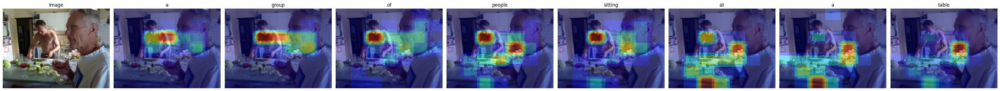


=== Image 2: COCO_train2014_000000149212.jpg ===
Generated caption: a plate of food with broccoli and vegetables .


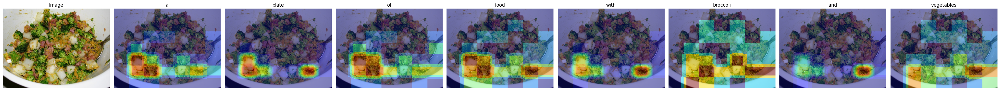


=== Image 3: COCO_train2014_000000536900.jpg ===
Generated caption: a group of people standing on a table with a pizza .


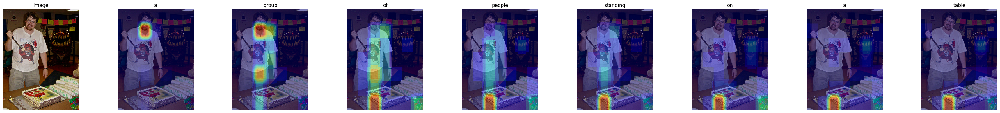


=== Image 4: COCO_train2014_000000328900.jpg ===
Generated caption: a woman standing in front of a cell phone .


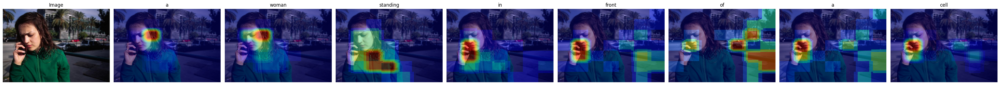


=== Image 5: COCO_train2014_000000077805.jpg ===
Generated caption: a man is standing on a beach with a body of water .


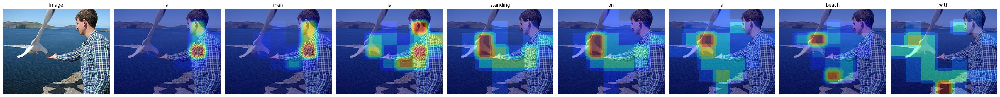


=== Image 6: COCO_train2014_000000012386.jpg ===
Generated caption: a group of people on the beach with a body of water .


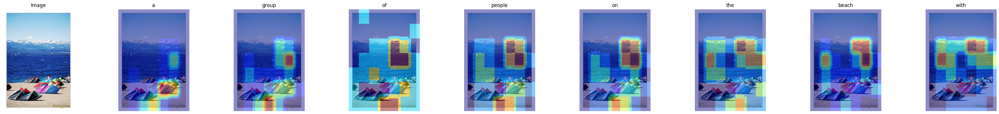


=== Image 7: COCO_train2014_000000459184.jpg ===
Generated caption: a woman sitting on a bench in front of a car .


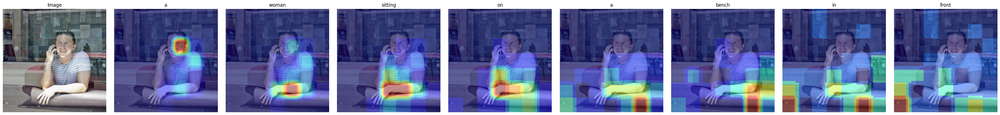


=== Image 8: COCO_train2014_000000524730.jpg ===
Generated caption: a city street with a clock on the street .


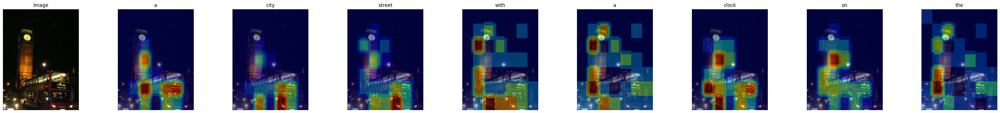


=== Image 9: COCO_train2014_000000488424.jpg ===
Generated caption: a red bus driving down a street .


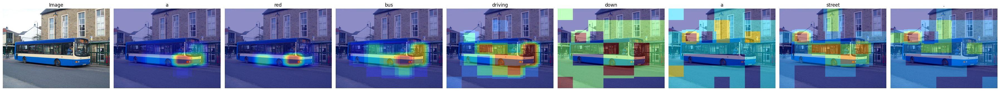


=== Image 10: COCO_train2014_000000117016.jpg ===
Generated caption: a table with a plate of food on a table .


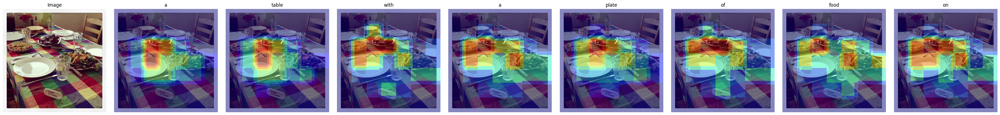


=== Image 11: COCO_train2014_000000474846.jpg ===
Generated caption: a red fire hydrant with a fire hydrant .


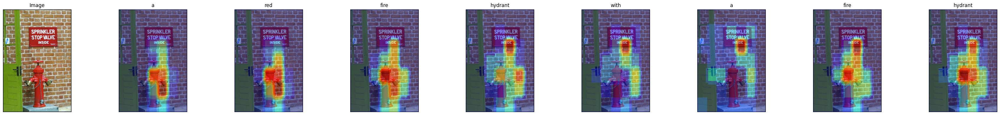


=== Image 12: COCO_train2014_000000147597.jpg ===
Generated caption: a group of people walking down a snowy hill .


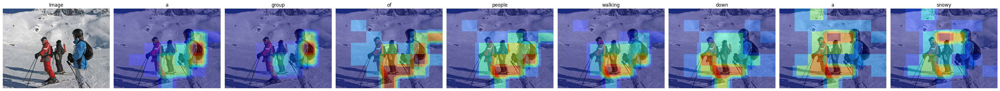


=== Image 13: COCO_train2014_000000572467.jpg ===
Generated caption: a woman is holding a tennis racket at a tennis ball .


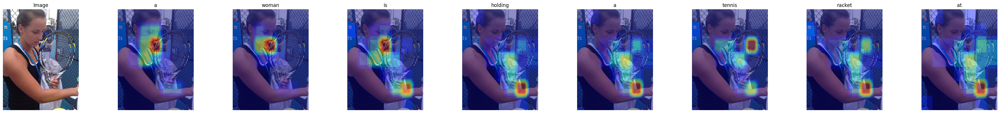


=== Image 14: COCO_train2014_000000053752.jpg ===
Generated caption: a plate of food on a table .


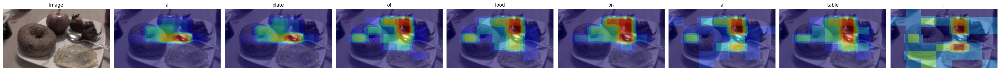


=== Image 15: COCO_train2014_000000071138.jpg ===
Generated caption: a group of people standing next to each other .


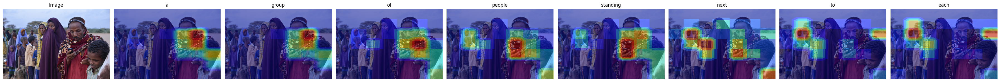


=== Image 16: COCO_train2014_000000333474.jpg ===
Generated caption: a black and white photo of a green field in a field .


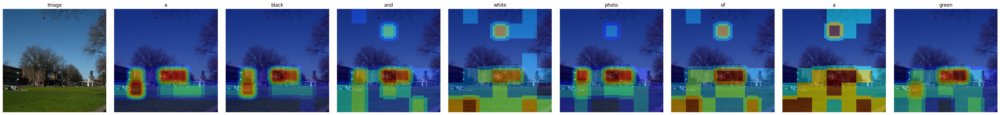


=== Image 17: COCO_train2014_000000314279.jpg ===
Generated caption: a stop sign with a sign on it .


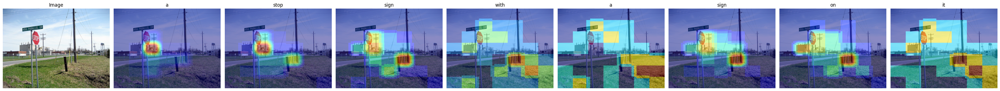


=== Image 18: COCO_train2014_000000474721.jpg ===
Generated caption: a couple of a giraffe standing next to a fence .


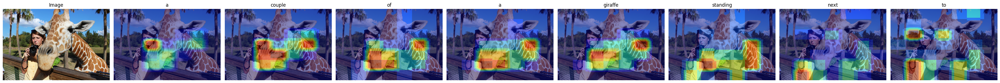


=== Image 19: COCO_train2014_000000566432.jpg ===
Generated caption: a plate of food on a plate on a table .


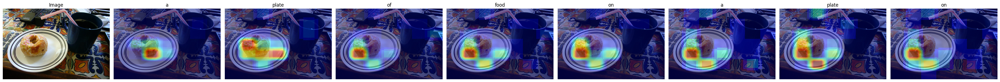


=== Image 20: COCO_train2014_000000015595.jpg ===
Generated caption: a zebra standing in a grassy field with a fence .


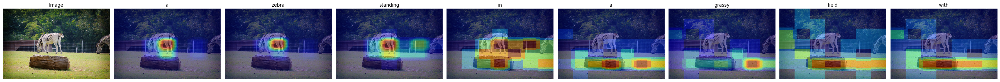

In [13]:
#@title Demo: multiple images + captions + attention maps
NUM_IMAGES = 20

image_files = [f for f in os.listdir(IMG_DIR) if f.endswith(".jpg")]
random_images = random.sample(image_files, NUM_IMAGES)

for i, fn in enumerate(random_images, 1):
    print(f"\n=== Image {i}: {fn} ===")
    pil_img = Image.open(os.path.join(IMG_DIR, fn)).convert("RGB")

    caption, words, attns = generate_beam_with_attention(model, pil_img, beam_size=3, max_len=MAX_LEN)

    print("Generated caption:", caption)
    show_word_attention(pil_img, words, attns, max_words=8)


In [ ]:
#@title Optional GUI (Gradio)
import gradio as gr

def make_overlay(pil_img, attn_map, alpha=0.45):
    att = (attn_map - attn_map.min()) / (attn_map.max() - attn_map.min() + 1e-8)
    att_img = Image.fromarray((att * 255).astype(np.uint8)).resize(pil_img.size, Image.BILINEAR)
    att_np = np.array(att_img) / 255.0

    fig = plt.figure(figsize=(5,4))
    plt.imshow(pil_img)
    plt.imshow(att_np, cmap="jet", alpha=alpha)
    plt.axis("off")
    buf = io.BytesIO()
    plt.tight_layout(pad=0)
    plt.savefig(buf, format="png", dpi=150, bbox_inches="tight", pad_inches=0)
    plt.close(fig)
    buf.seek(0)
    return Image.open(buf).convert("RGB")

def caption_and_heatmaps(image):
    pil_img = Image.fromarray(image).convert("RGB")
    caption, words, attns = generate_beam_with_attention(model, pil_img, beam_size=3, max_len=MAX_LEN)

    overlays = []
    shown = 0
    for w, a in zip(words[1:], attns):
        if w in ["<end>", "<pad>"]:
            break
        overlays.append(make_overlay(pil_img, a))
        shown += 1
        if shown >= 8:
            break

    return caption, overlays

demo = gr.Interface(
    fn=caption_and_heatmaps,
    inputs=gr.Image(type="numpy", label="Upload an image"),
    outputs=[
        gr.Textbox(label="Generated Caption"),
        gr.Gallery(label="Attention Heatmaps (per word)", columns=4),
    ],
    title="Explainable Image Captioning (ResNet-50 + LSTM + Attention)",
    description="Upload an image → caption + attention heatmaps per generated word."
)

demo.launch(share=True)
